# Import and set colors

In [1]:
import scanpy as sc
import anndata as ann
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import cm, colors
from gprofiler import gprofiler

import os 
#pretty plotting
import seaborn as sb


In [2]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [3]:
plt.rcParams['figure.figsize']=(5,5) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=True, fontsize=12, color_map=mymap2)
sc.logging.print_header()

scanpy==1.7.1 anndata==0.7.5 umap==0.5.1 numpy==1.22.3 scipy==1.8.0 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.4


# Set project file paths

In [4]:
file_path = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Revision/'
#this is my file path please adapt it to your directory

In [5]:
data_dir =file_path +  'data/' 

In [6]:
table_dir = file_path + 'tables/'

In [7]:
sc.settings.figdir = file_path + 'figures/5a_subclustering/'

In [8]:
import datetime

today = datetime.date.today().strftime('%y%m%d') #creates a YYMMDD string of today's date

# Astrocytes

In [9]:
adata_all_astros_proc = sc.read(data_dir + '230721adata_ctr_astros_proc_scVI.h5ad')

In [10]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_all_astros_proc.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_all_astros_proc, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_all_astros_proc.n_vars))

Total number of genes: 19290
filtered out 4328 genes that are detected in less than 20 cells
Number of genes after cell filter: 14962


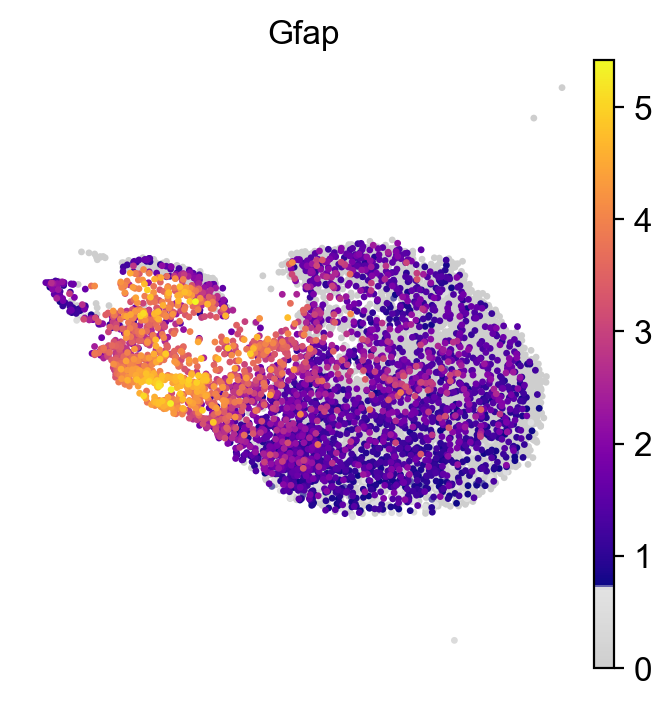

In [11]:
sc.pl.umap(adata_all_astros_proc, color=['Gfap'], frameon=False, wspace=0.5,cmap=mymap2, size=24)

In [12]:
set(adata_all_astros_proc.obs['condition'])

{'3dpi_CTRL', '5dpi_CTRL', 'INTACT'}

In [13]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_astros_proc, use_rep="X_scVI")


computing neighbors


OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)


In [14]:
sc.tl.umap(adata_all_astros_proc)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


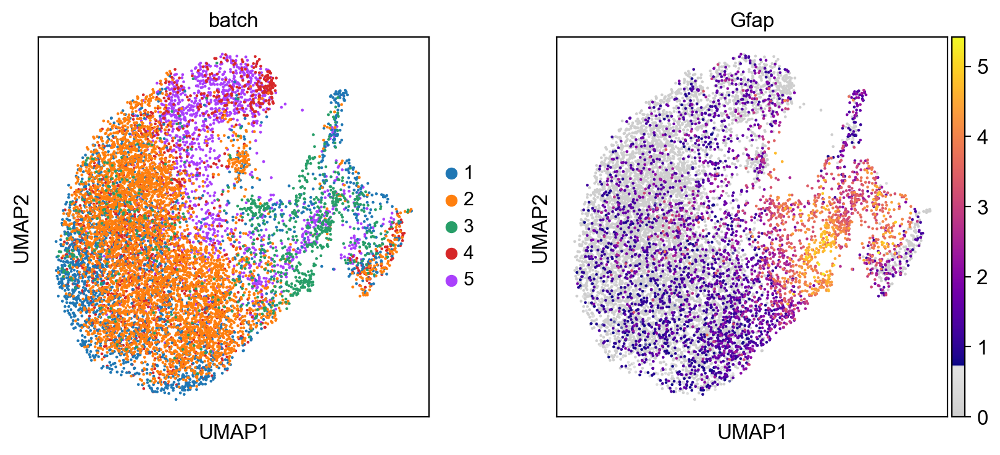

In [15]:
sc.pl.umap(adata_all_astros_proc, color=['batch','Gfap',])

In [16]:
# Perform clustering - using highly variable genes
sc.tl.leiden(adata_all_astros_proc, key_added='leiden_astros_r1')
sc.tl.leiden(adata_all_astros_proc, resolution=0.5, key_added='leiden_astros_r0.5')

running Leiden clustering
    finished: found 15 clusters and added
    'leiden_astros_r1', the cluster labels (adata.obs, categorical) (0:00:01)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden_astros_r0.5', the cluster labels (adata.obs, categorical) (0:00:01)


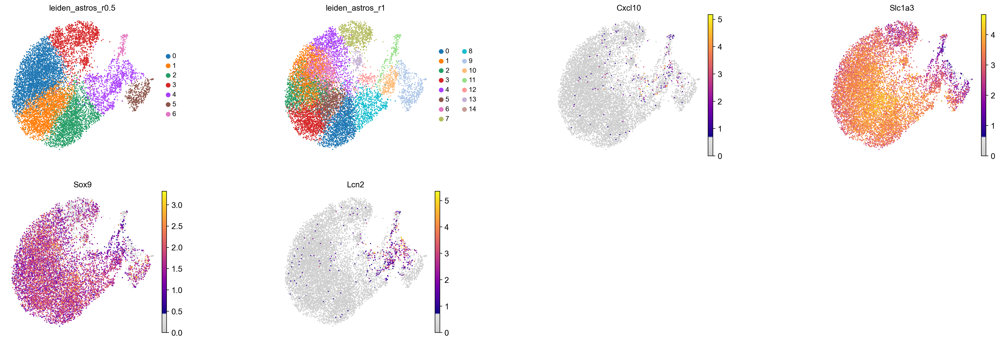

In [17]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_astros_proc, color=['leiden_astros_r0.5','leiden_astros_r1','Cxcl10', 'Slc1a3','Sox9','Lcn2'], legend_fontsize =float(10),
           wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

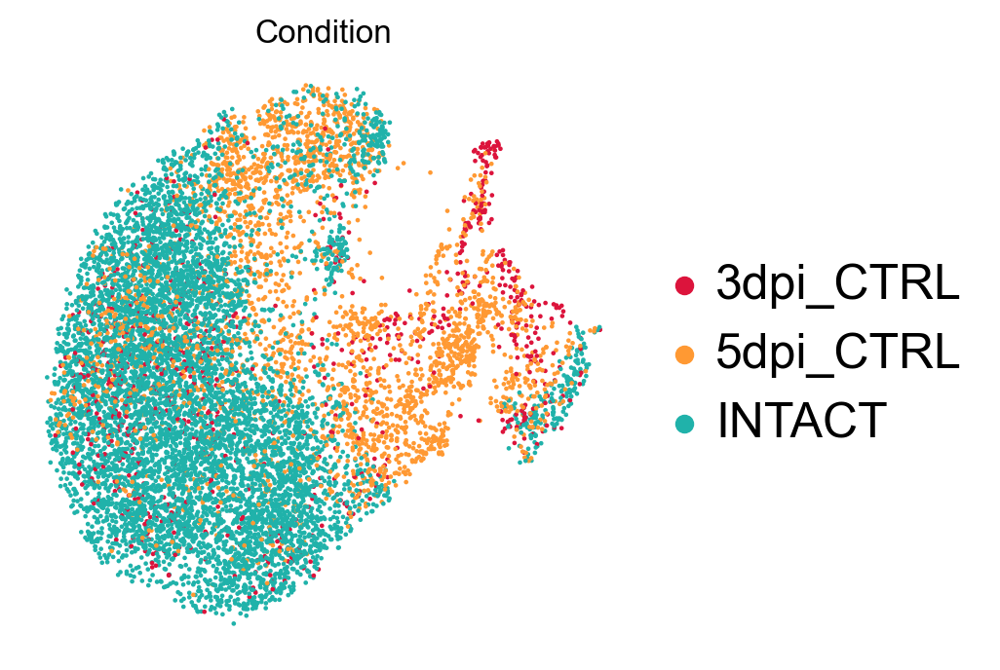

In [18]:
sc.pl.umap(adata_all_astros_proc, color=['condition'], legend_fontsize =float(18),  legend_fontweight= 'normal', title= 'Condition',
           frameon= False, save=today+'_3A_condition.pdf' )

In [19]:
# Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_all_astros_proc, groupby='leiden_astros_r0.5', key_added='rank_genes_astros_r0.5', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_astros_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_astros_r0.5']`


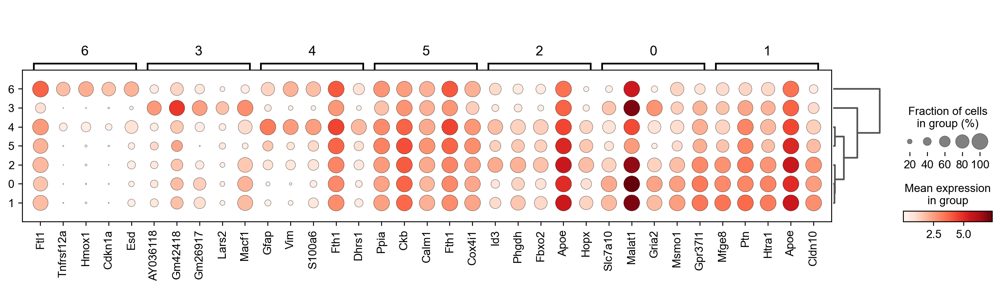

In [20]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata_all_astros_proc, n_genes=5, key='rank_genes_astros_r0.5',)

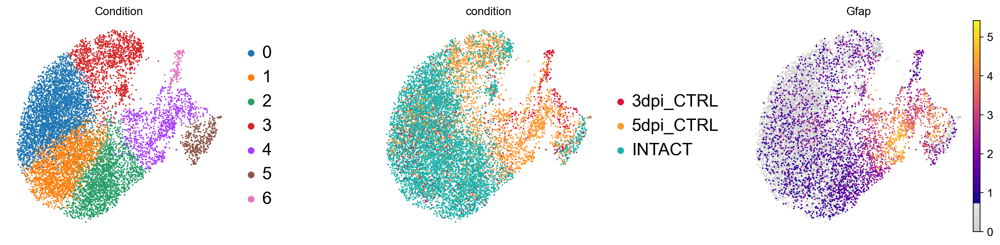

In [21]:
sc.pl.umap(adata_all_astros_proc, color=['leiden_astros_r0.5','condition','Gfap'], legend_fontsize =float(18),  legend_fontweight= 'normal', title= 'Condition', wspace=0.5,
           frameon= False)

In [22]:
clustersA= ['#b3d9ff',# 1
            '#4169E1',# 2
            '#bdcbf5',#3
            '#4da6ff',# 0
            '#ff6666',# 4
            '#DC143C',# 5
            '#ffb399',#7
            '#333399'
              ]

In [23]:
cluster2annotation = {
    '0': 'AG1',
    '1': 'AG2',
    '2': 'AG3',
    '3': 'AG4',
    '4': 'AG5',
    '5': 'AG6',
    '6': 'AG7',
    }

In [24]:
adata_all_astros_proc.obs['clustersastros'] = adata_all_astros_proc.obs['leiden_astros_r0.5'].map(cluster2annotation).astype('category')

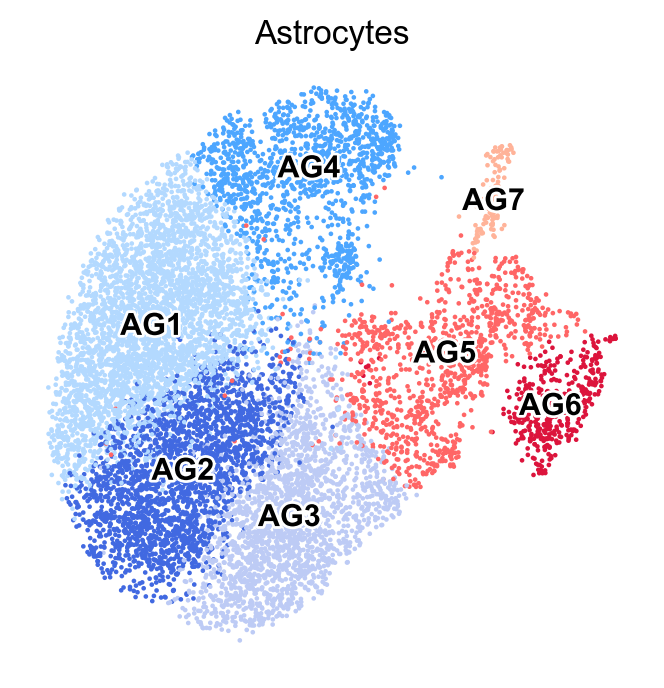

In [26]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_astros_proc, color=['clustersastros'],title='Astrocytes',legend_fontoutline=2,legend_loc='on data',legend_fontsize =float(11),
           wspace=0.6, legend_fontweight= 'black', frameon= False,palette=clustersA, save=today+'_3A_annotated.pdf')

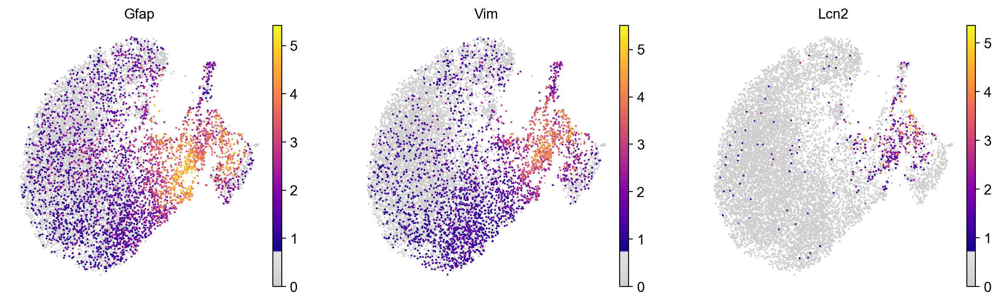

In [147]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_astros_proc, color=['Gfap', 'Vim', 'Lcn2'],
           frameon= False, save=today+'_3A_genes.pdf')

In [27]:
print(adata_all_astros_proc.obs['condition'].value_counts())

INTACT       7135
5dpi_CTRL    2765
3dpi_CTRL     849
Name: condition, dtype: int64


In [28]:
intact_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='INTACT'],n_obs=849,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='5dpi_CTRL'],n_obs=849,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='3dpi_CTRL'],n_obs=849,copy=True).obs_names
adata_all_astros_proc_subsam = adata_all_astros_proc[list(intact_subsam) + list(five_dpi_V_subsam)+list(three_dpi_V_subsam)].copy()

In [29]:
sc.tl.embedding_density(adata_all_astros_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


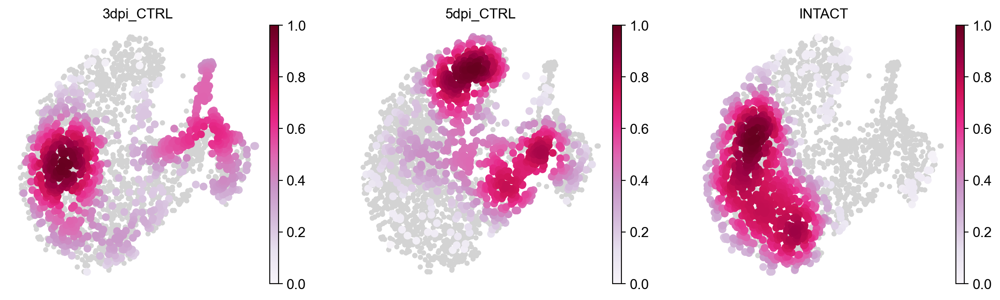

In [30]:
sc.pl.embedding_density(adata_all_astros_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd', frameon= False, ncols=5, save=today+'_distribution_downscaling_astros.pdf')

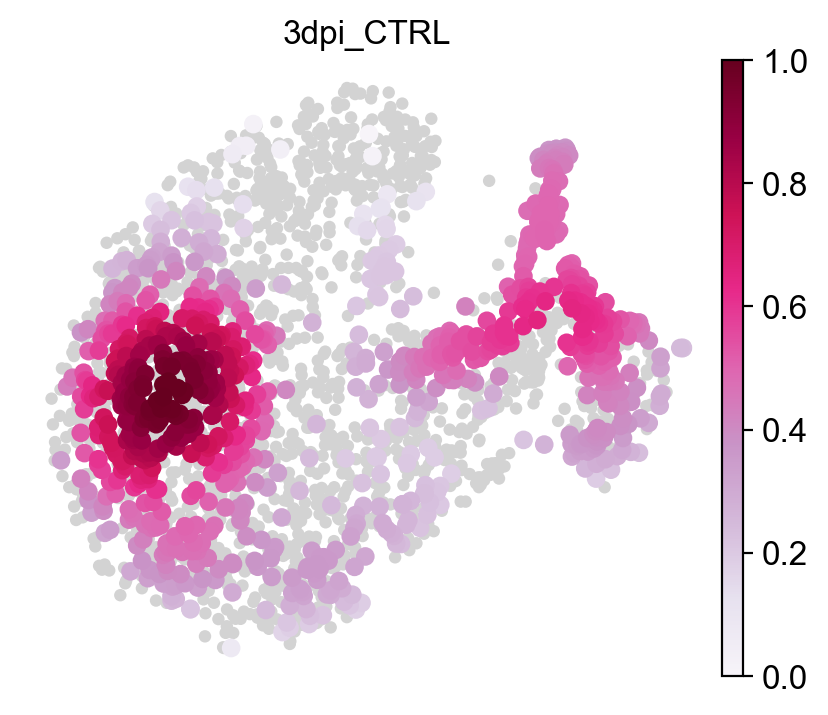

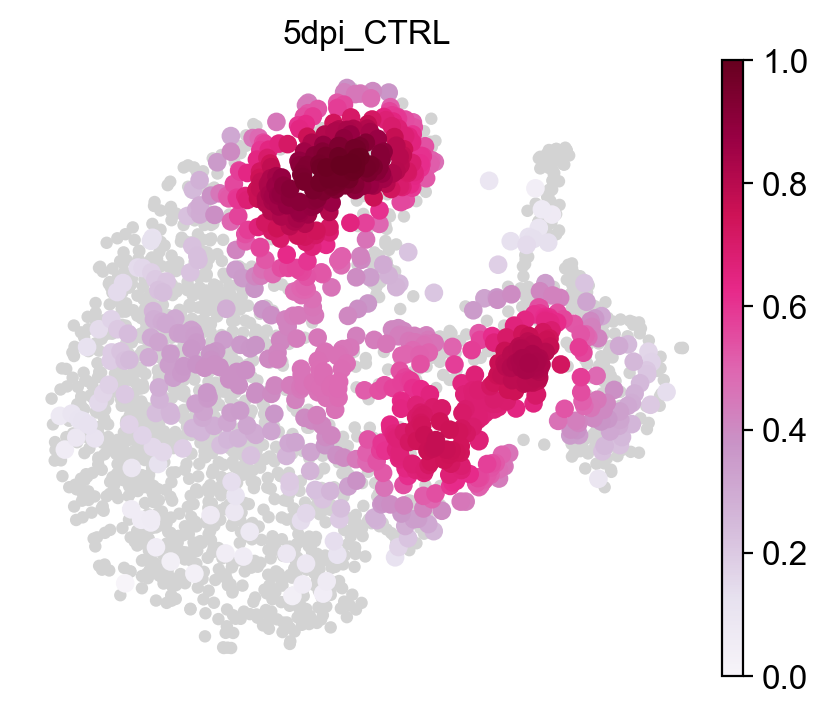

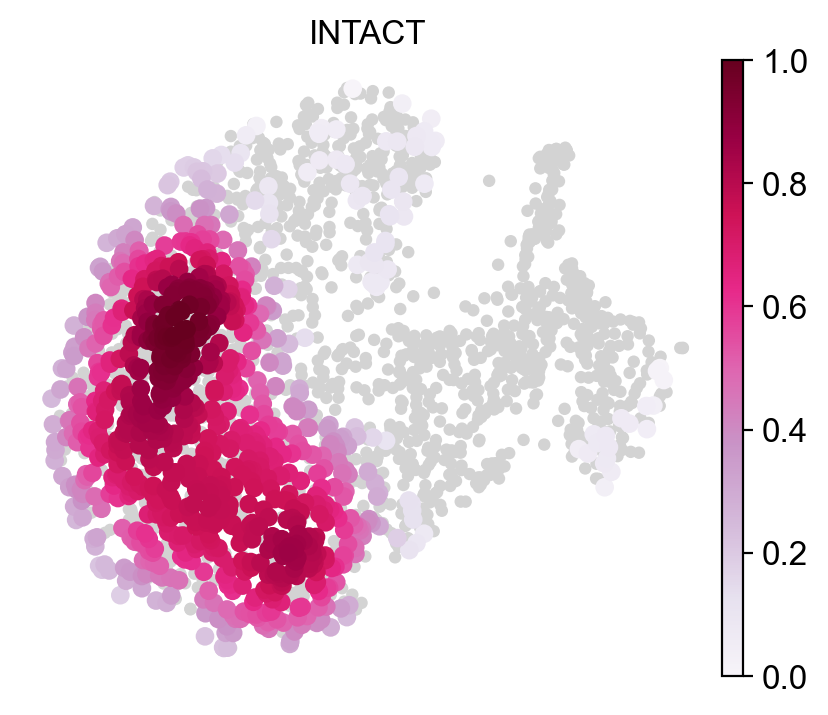

In [31]:
for i in set(adata_all_astros_proc_subsam.obs['condition']):
                                          sc.pl.embedding_density(adata_all_astros_proc_subsam, basis='umap',  key='umap_density_condition', group=i,
                        color_map='PuRd', frameon= False, ncols=5, save=today+i+'_distribution_downscaling_astros.pdf')

In [32]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_all_astros_proc, groupby='clustersastros', key_added='rank_genes_astros_clustersastros', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_astros_clustersastros']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_clustersastros']`


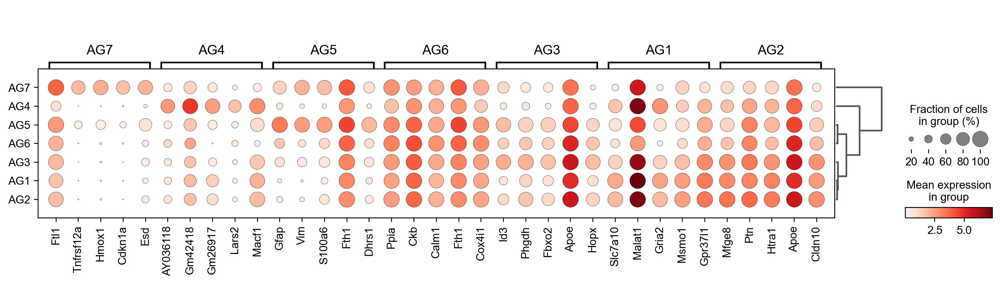

In [33]:
sc.pl.rank_genes_groups_dotplot(adata_all_astros_proc, n_genes=5, key='rank_genes_astros_clustersastros', cmap='Reds', 
                                save=today+'rank_astros.pdf')

In [34]:
result = adata_all_astros_proc.uns['rank_genes_astros_clustersastros']
groups = result['names'].dtype.names
adata_clastros_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [35]:
adata_clastros_genes

,AG1_n,AG1_s,AG1_p,AG1_l,AG2_n,AG2_s,AG2_p,AG2_l,AG3_n,AG3_s,...,AG5_p,AG5_l,AG6_n,AG6_s,AG6_p,AG6_l,AG7_n,AG7_s,AG7_p,AG7_l
0,Slc7a10,43.547459,0.000000e+00,1.379575,Mfge8,41.100616,3.773173e-301,1.561670,Id3,41.027634,...,0.000000e+00,5.357884,Ppia,15.138678,3.324779e-45,1.088686,Ftl1,19.152924,2.938503e-49,3.252483
1,Malat1,38.758152,4.606295e-284,1.543282,Ptn,38.317734,5.295736e-270,1.058733,Phgdh,34.841366,...,2.173889e-322,5.044714,Ckb,13.940978,2.284023e-39,0.871210,Tnfrsf12a,17.645786,1.304993e-36,6.352752
2,Gria2,36.609291,4.049981e-267,1.288371,Htra1,32.784874,3.644919e-205,1.031313,Fbxo2,32.414410,...,1.877449e-322,3.860344,Calm1,13.361035,8.843976e-37,0.993278,Hmox1,17.006495,8.855984e-35,6.440879
3,Msmo1,34.373192,4.062673e-238,1.165712,Apoe,32.489883,3.928584e-200,0.981608,Apoe,32.121075,...,0.000000e+00,2.170881,Fth1,13.358881,8.996877e-37,1.028013,Cdkn1a,16.235439,7.328733e-33,6.306384
4,Gpr37l1,32.829193,1.454874e-215,0.916537,Cldn10,30.538523,1.541482e-181,1.127953,Hopx,32.094749,...,3.198222e-254,3.286689,Cox4i1,12.994819,6.378422e-35,0.961875,Esd,15.694853,7.159843e-36,3.877736
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,S100a6,-23.265913,9.139955e-115,-1.440772,Serpina3n,-12.901673,3.845825e-37,-2.381631,Sparc,-19.182457,...,2.333804e-170,-2.425984,Son,-31.421215,2.572138e-140,-3.365712,Acsl3,-19.305691,1.736700e-48,-4.238826
19286,S100a10,-23.425476,7.520786e-116,-1.974428,S100a11,-12.922335,3.955400e-37,-2.789725,Slc7a10,-19.229742,...,7.105395e-218,-1.964820,Gm3764,-32.142384,1.928475e-136,-4.487207,S1pr1,-19.368820,2.114381e-49,-3.925438
19287,Id3,-28.205927,1.851123e-165,-1.552041,Fth1,-13.669965,1.483482e-41,-0.410202,Gria2,-25.111149,...,4.257682e-226,-2.623598,Dclk1,-32.329033,3.289353e-146,-3.678189,Btbd17,-19.473686,9.924191e-41,-6.071012
19288,Gfap,-30.608589,9.275325e-189,-2.581208,Vim,-15.946054,3.709171e-55,-1.716693,Gm26917,-25.490709,...,6.533020e-236,-2.645764,Pnisr,-32.463467,2.384053e-134,-4.770603,Cspg5,-20.580940,1.678778e-53,-3.737059


In [36]:
adata_clastros_genes.to_csv(table_dir+today+"adata_clastros_genes.csv")

In [37]:
adata_all_astros_proc.write(data_dir+today+'adata_all_astros_proc_annotated.h5ad')

In [38]:
adata_all_astros_proc

AnnData object with n_obs × n_vars = 10749 × 14962
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_ctr', 'leiden_ctr07', 'leiden_ctr2', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'annotated', 'annotatedgroup', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2'

# Microglia

In [39]:
adata_all_micro_proc=sc.read(data_dir + "230721adata_ctr_micro_only_proc_scVI.h5ad")

In [40]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_all_micro_proc.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_all_micro_proc, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_all_micro_proc.n_vars))

Total number of genes: 19290
filtered out 5362 genes that are detected in less than 20 cells
Number of genes after cell filter: 13928


In [41]:
set(adata_all_micro_proc.obs['condition'])

{'3dpi_CTRL', '5dpi_CTRL', 'INTACT'}

In [42]:
adata_all_micro_proc

AnnData object with n_obs × n_vars = 6865 × 13928
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_ctr', 'leiden_ctr07', 'leiden_ctr2', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'annotated', 'annotatedgroup', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2'


In [43]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_micro_proc, use_rep="X_scVI")


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [44]:
sc.tl.umap(adata_all_micro_proc,)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


In [45]:
# Perform clustering - using highly variable genes
sc.tl.leiden(adata_all_micro_proc, key_added='leiden_micro_r1')
sc.tl.leiden(adata_all_micro_proc, resolution=0.5, key_added='leiden_micro_r0.5')

running Leiden clustering
    finished: found 12 clusters and added
    'leiden_micro_r1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_micro_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)


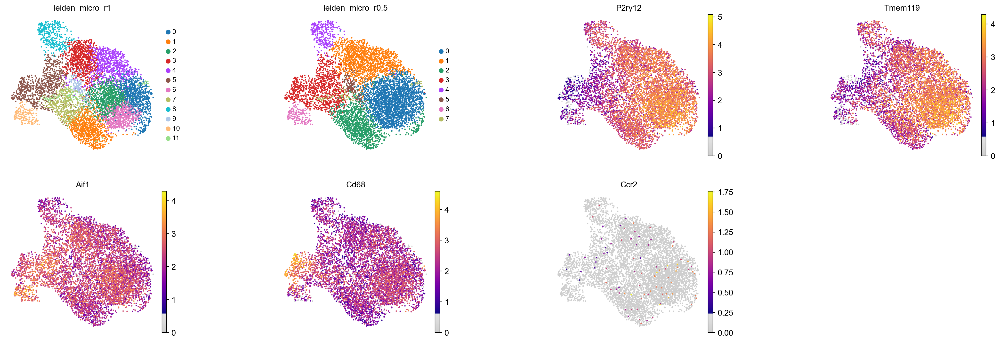

In [46]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_micro_proc, color=['leiden_micro_r1','leiden_micro_r0.5',
                                        'P2ry12','Tmem119', 'Aif1', 'Cd68','Ccr2'], legend_fontsize =float(10),
           wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

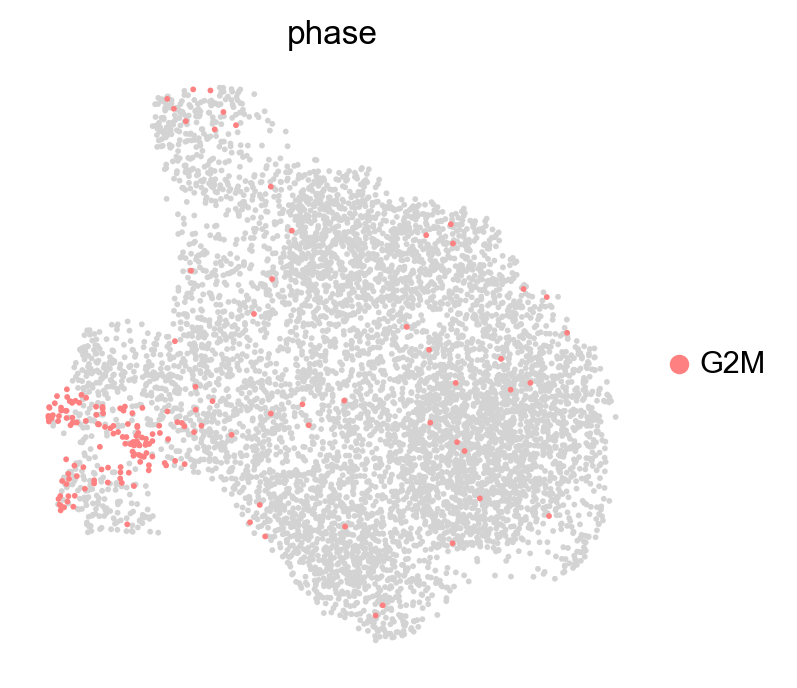

In [47]:
sc.pl.umap(adata_all_micro_proc, color=['phase'], groups=['G2M'], na_in_legend=False, cmap=mymap2, frameon= False )#, save='_micro_g2m_all.png')

In [48]:
print(adata_all_micro_proc.obs['condition'].value_counts())

INTACT       3619
5dpi_CTRL    2644
3dpi_CTRL     602
Name: condition, dtype: int64


In [64]:
intact_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='INTACT'],n_obs=601,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='5dpi_CTRL'],n_obs=601,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='3dpi_CTRL'],n_obs=601,copy=True).obs_names
adata_all_micro_proc_subsam = adata_all_micro_proc[list(intact_subsam) + list(five_dpi_V_subsam)+list(three_dpi_V_subsam)].copy()

In [65]:
sc.tl.embedding_density(adata_all_micro_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


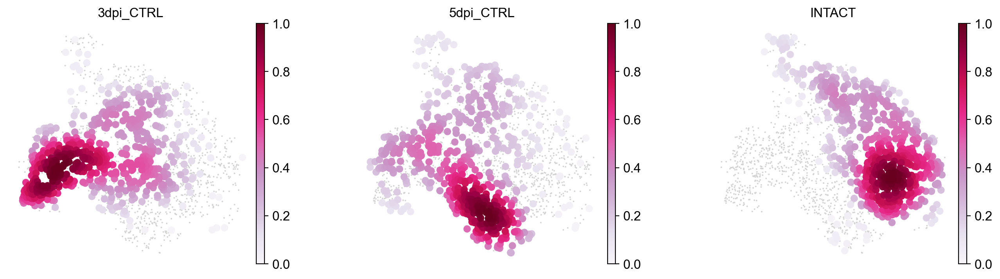

In [51]:
sc.pl.embedding_density(adata_all_micro_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd', wspace=0.3, bg_dotsize = 8, frameon= False, ncols=5, save='_distribution_downscaling_ctr.pdf')

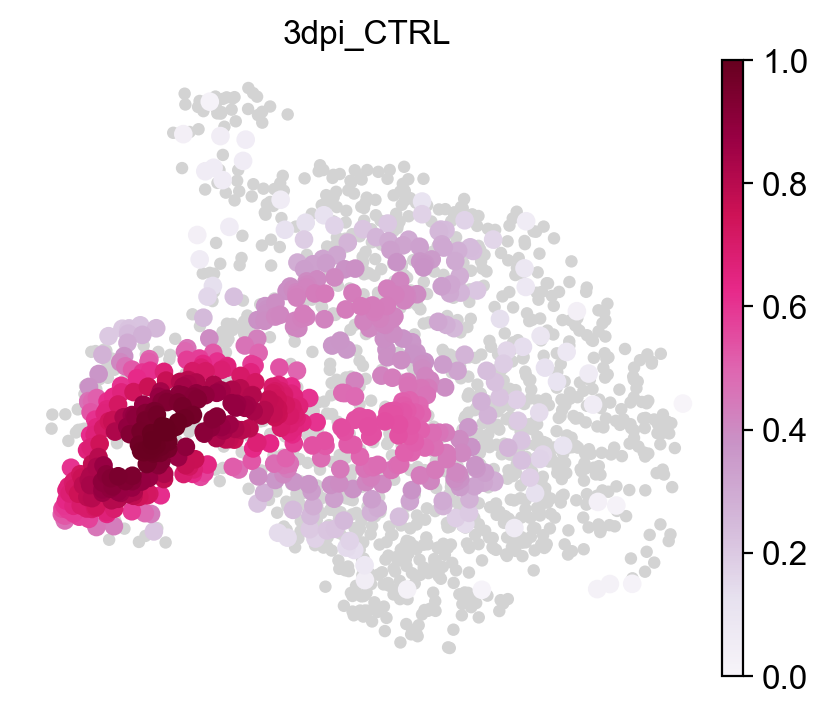

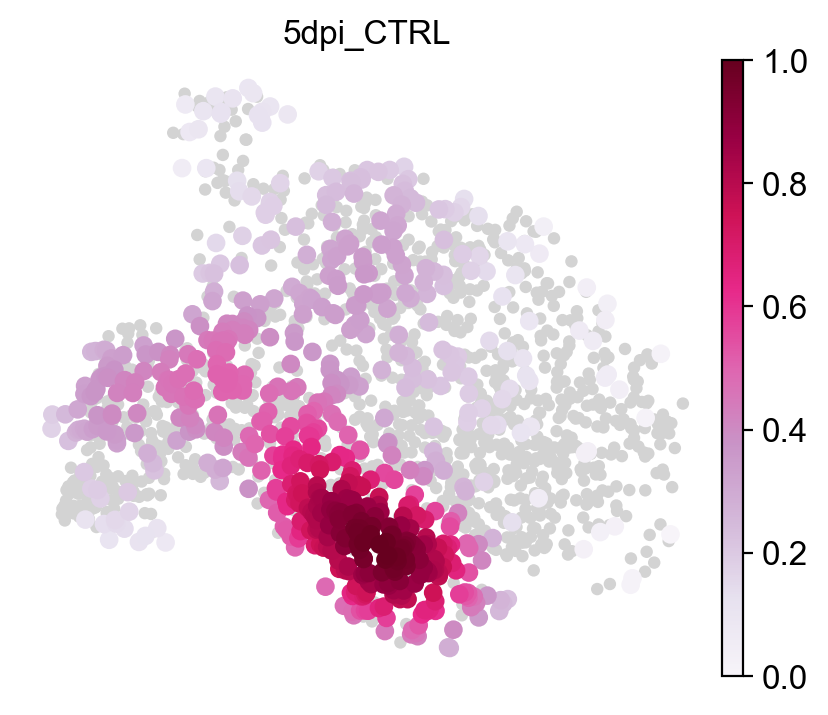

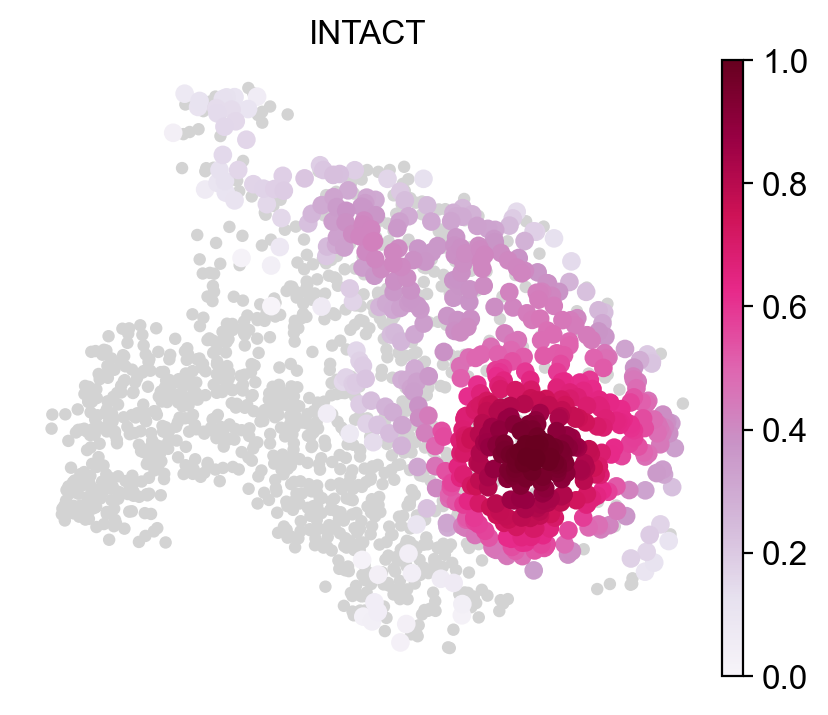

In [67]:
for i in set(adata_all_micro_proc_subsam.obs['condition']):
    sc.pl.embedding_density(adata_all_micro_proc_subsam, basis='umap',  key='umap_density_condition',group=i,
                            color_map='PuRd', frameon= False, ncols=5, 
                            save=today+i+'_distribution_downscaling_ctr.pdf')

In [54]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_all_micro_proc, groupby='leiden_micro_r0.5', key_added='rank_genes_micro_r0.5', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_micro_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_micro_r0.5']`


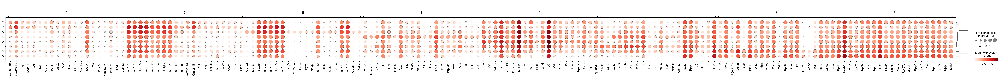

In [55]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata_all_micro_proc, n_genes=20, key='rank_genes_micro_r0.5',)

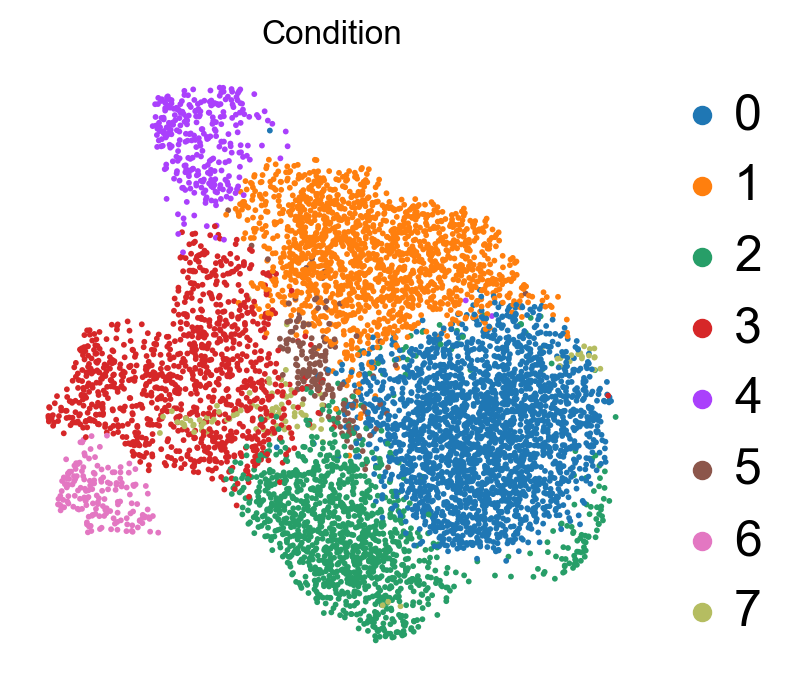

In [56]:
sc.pl.umap(adata_all_micro_proc, color=['leiden_micro_r0.5'], legend_fontsize =float(18), legend_fontweight= 'normal', title= 'Condition',
           frameon= False,)

In [57]:
clustersM= ['#4da6ff',
            '#b3d9ff',
            '#4169E1',
            '#ff6666',
            '#bdcbf5',
            '#92a8d1',
            '#ffb399',
            '#333399',
            '#b3e6ff'
      ]

In [58]:
cluster2annotation = {
    '0': 'MG1',
    '1': 'MG2',
    '2': 'MG3',
    '3': 'MG4',
    '4': 'MG5',
    '5': 'MG6',
    '6': 'MG7',
    '7': 'MG8',
    }

In [59]:
adata_all_micro_proc.obs['clustersmicro'] = adata_all_micro_proc.obs['leiden_micro_r0.5'].map(cluster2annotation).astype('category')

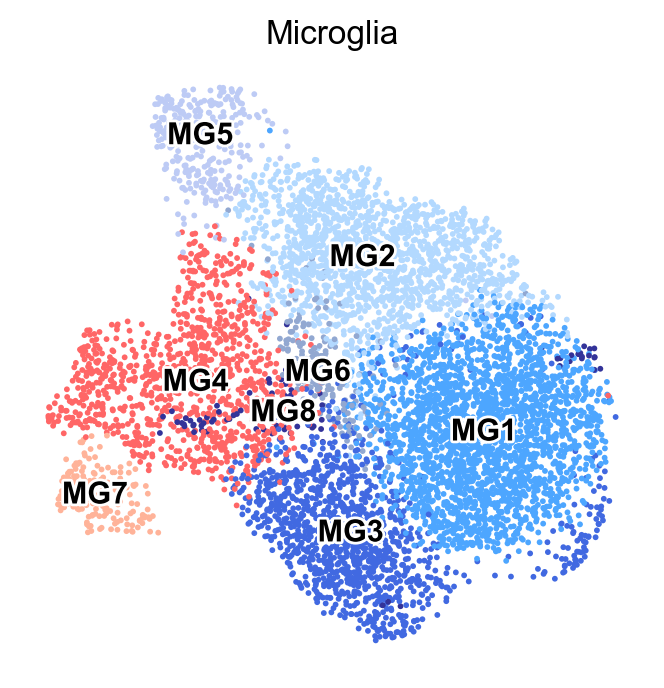

In [139]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_micro_proc, color=['clustersmicro'], title='Microglia',legend_fontoutline=2,legend_loc='on data',legend_fontsize =float(11),
           wspace=0.6, legend_fontweight= 'black', frameon= False,palette=clustersM, save=today+'_1M_clusters.pdf'  )

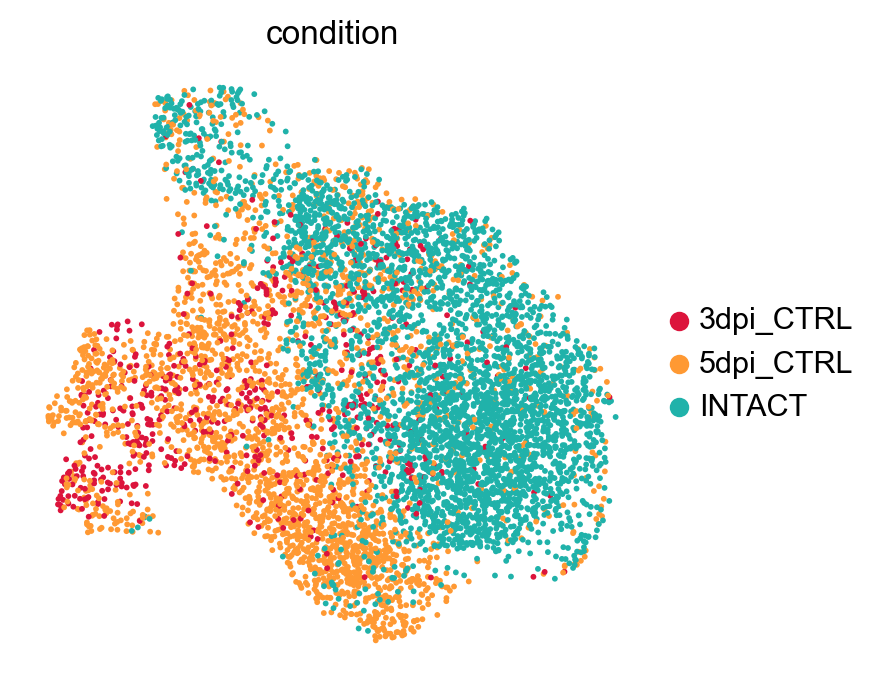

In [149]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_micro_proc, color=['condition'],legend_fontsize =float(11),
         legend_fontweight= 'black', frameon= False, save=today+'_1M_condition.pdf'  )

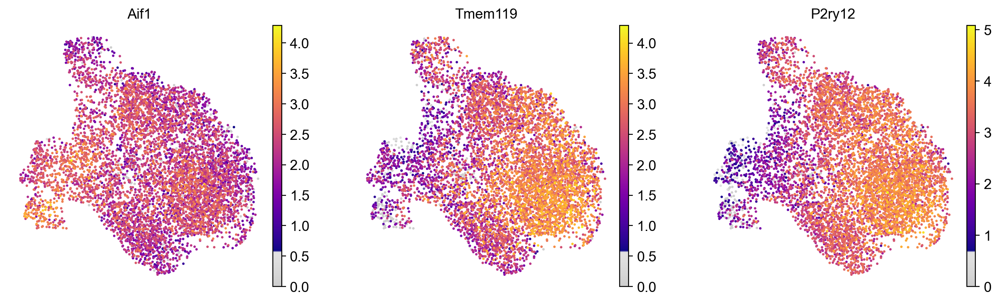

In [150]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_micro_proc, color=['Aif1', 'Tmem119', 'P2ry12'],legend_fontsize =float(11),
         legend_fontweight= 'black', frameon= False, save=today+'_1M_genes.pdf'  )

In [69]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_all_micro_proc, groupby='clustersmicro', key_added='rank_genes_clustersmicro', 
                        method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_clustersmicro']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_clustersmicro']`


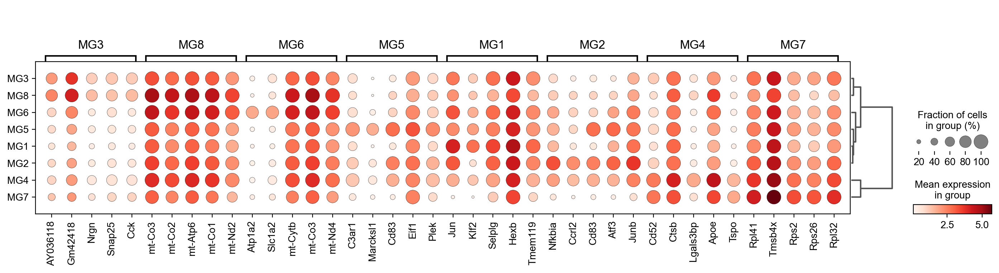

In [70]:
sc.pl.rank_genes_groups_dotplot(adata_all_micro_proc, n_genes=5, key='rank_genes_clustersmicro', cmap='Reds', save=today+'rank_micro.pdf')

In [71]:
result = adata_all_micro_proc.uns['rank_genes_clustersmicro']
groups = result['names'].dtype.names
adata_aclmicro_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [72]:
adata_aclmicro_genes

,MG1_n,MG1_s,MG1_p,MG1_l,MG2_n,MG2_s,MG2_p,MG2_l,MG3_n,MG3_s,...,MG6_p,MG6_l,MG7_n,MG7_s,MG7_p,MG7_l,MG8_n,MG8_s,MG8_p,MG8_l
0,Jun,50.573635,0.000000e+00,2.346234,Nfkbia,46.682762,0.000000e+00,2.984987,AY036118,24.119673,...,4.381842e-45,4.077260,Rpl41,19.880787,2.509666e-53,2.116300,mt-Co3,12.605556,4.252330e-27,2.256830
1,Klf2,43.885292,0.000000e+00,2.897394,Ccrl2,41.897385,3.146802e-303,2.929037,Gm42418,23.186644,...,4.650325e-41,3.220961,Tmsb4x,19.264988,7.559973e-56,1.604492,mt-Co2,12.367325,2.097321e-26,2.531203
2,Selplg,42.248104,7.457427e-319,1.350632,Cd83,41.242542,1.361708e-295,2.879581,Nrgn,20.922533,...,2.411485e-36,1.668857,Rps2,18.113104,3.201465e-49,2.139966,mt-Atp6,11.597341,5.807347e-24,2.158673
3,Hexb,39.071808,1.006884e-284,0.839250,Atf3,37.101311,7.289718e-247,2.563648,Snap25,20.049366,...,6.084826e-35,1.613444,Rps26,17.657913,2.085356e-47,2.336239,mt-Co1,11.410402,1.771152e-23,2.294753
4,Tmem119,38.594055,3.700431e-277,1.276856,Junb,36.547981,1.092338e-235,2.023444,Cck,19.830057,...,9.331170e-34,1.743470,Rpl32,17.364849,1.448002e-45,1.942846,mt-Nd2,11.283959,4.442327e-23,2.204774
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Rpl27a,-35.259201,6.973186e-242,-1.128433,Ctsb,-12.747281,3.552703e-36,-0.496438,Junb,-26.608524,...,2.234004e-08,-0.745208,Ier5,-20.663710,5.160195e-58,-4.444630,Tmsb4x,-11.012362,2.562654e-21,-1.696939
19286,Rps12,-36.340168,3.506575e-255,-1.378558,Ctsz,-12.908195,4.100505e-37,-0.449485,H3f3b,-28.858553,...,2.088504e-08,-0.552443,Rhob,-21.191477,2.193609e-63,-3.705556,Rps27,-11.050132,3.576678e-22,-2.307407
19287,Fau,-36.514774,4.623029e-257,-0.978668,Mafb,-18.218649,2.324023e-70,-1.169627,Ubc,-29.843723,...,1.289764e-08,-0.456481,Cx3cr1,-23.287182,1.234113e-67,-3.536694,Rps29,-12.207781,1.044196e-24,-2.269026
19288,Rpl32,-36.992466,2.785268e-263,-1.272349,Rsrp1,-19.006273,3.811735e-76,-1.176415,Ftl1,-32.498032,...,2.666656e-09,-0.468040,Jun,-25.800564,8.843540e-70,-6.306314,P2ry12,-12.379347,2.139540e-26,-2.835979


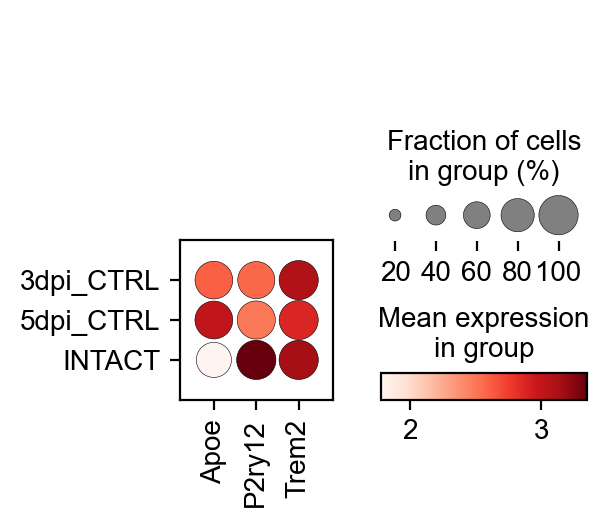

In [73]:
sc.pl.dotplot(adata_all_micro_proc_subsam, var_names=['Apoe', 'P2ry12', 'Trem2'], groupby='condition')

In [74]:
adata_aclmicro_genes.to_csv(table_dir+today+'adata_aclmicro_genes.csv')

In [75]:
adata_all_micro_proc.write(data_dir+today + "adata_all_micro_proc_cl_scVI.h5ad", compression='gzip')

In [143]:
adata_all_micro_proc

AnnData object with n_obs × n_vars = 6865 × 13928
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_ctr', 'leiden_ctr07', 'leiden_ctr2', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'annotated', 'annotatedgroup', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2',

# Oligodendrocytes

In [76]:
adata_all_oligos_proc=sc.read(data_dir + "230721adata_ctr_oligos_proc_scVI.h5ad")

In [77]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_all_oligos_proc.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_all_oligos_proc, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_all_oligos_proc.n_vars))

Total number of genes: 19290
filtered out 5915 genes that are detected in less than 20 cells
Number of genes after cell filter: 13375


In [78]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_astros_proc, use_rep="X_scVI")


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [79]:
sc.tl.umap(adata_all_oligos_proc)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


In [80]:
# Perform clustering - using highly variable genes
sc.tl.leiden(adata_all_oligos_proc, key_added='leiden_oligos_r1')
sc.tl.leiden(adata_all_oligos_proc, resolution=0.6, key_added='leiden_oligos_r0.5')

running Leiden clustering
    finished: found 12 clusters and added
    'leiden_oligos_r1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden_oligos_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)


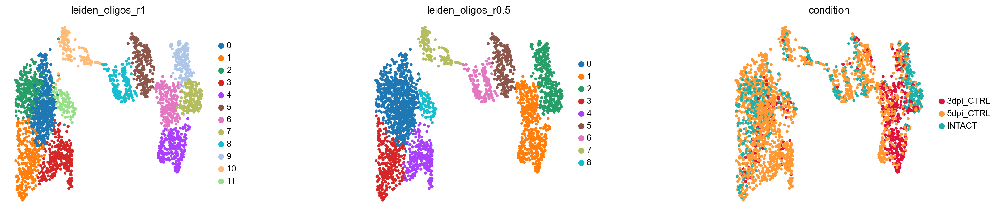

In [81]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_oligos_proc, color=['leiden_oligos_r1','leiden_oligos_r0.5' ,'condition'], legend_fontsize =float(10),
           wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

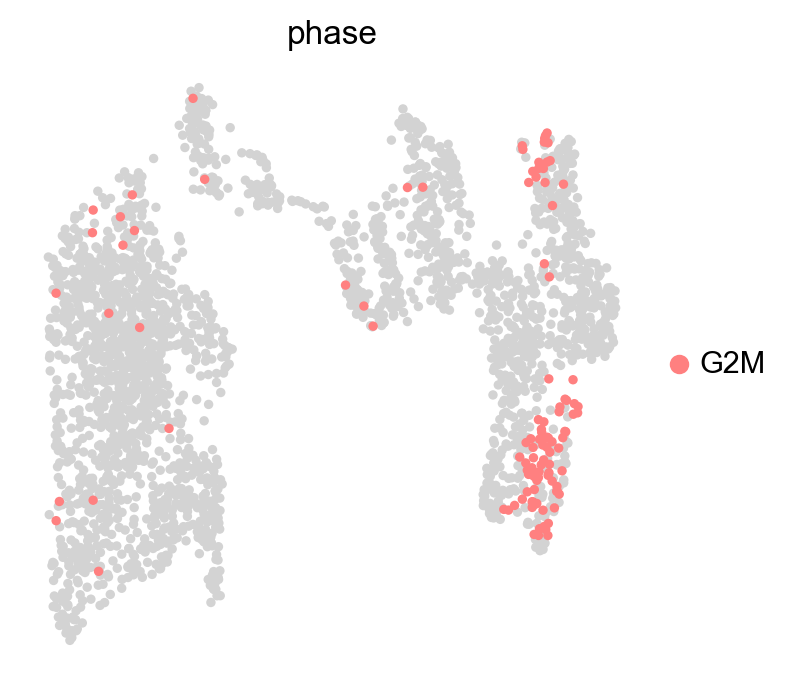

In [82]:
sc.pl.umap(adata_all_oligos_proc, color=['phase'], groups=['G2M'], na_in_legend=False, cmap=mymap2, frameon= False )#, save='_oligos_g2m_all.png')

In [83]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_all_oligos_proc, groupby='leiden_oligos_r0.5', key_added='rank_genes_oligos_r0.5', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_oligos_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_oligos_r0.5']`


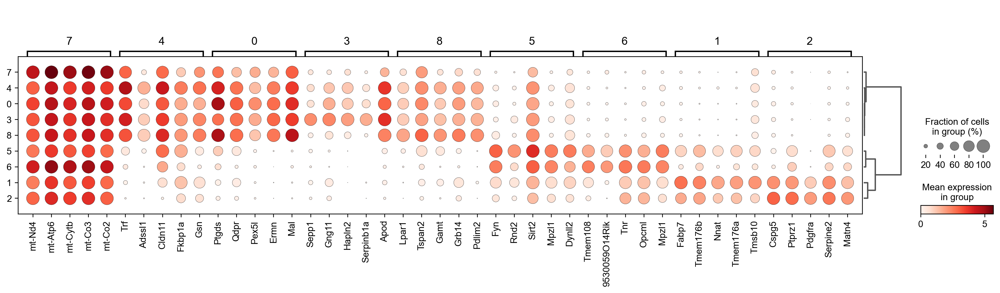

In [84]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata_all_oligos_proc, n_genes=5, key='rank_genes_oligos_r0.5', )

In [85]:
adata_all_oligos_proc

AnnData object with n_obs × n_vars = 2614 × 13375
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_ctr', 'leiden_ctr07', 'leiden_ctr2', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'annotated', 'annotatedgroup', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2',

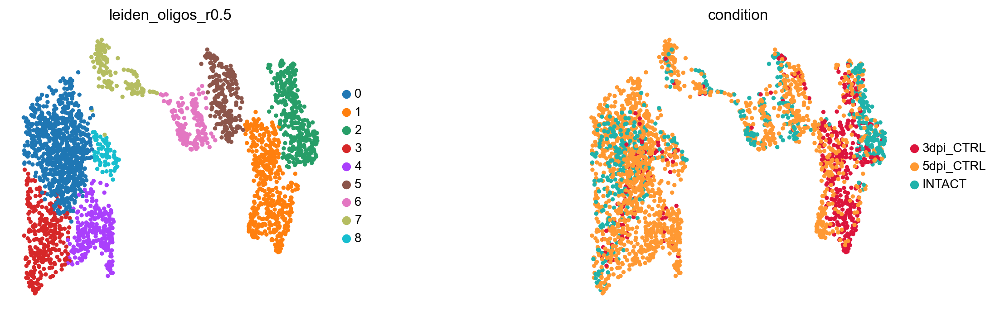

In [86]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_oligos_proc, color=['leiden_oligos_r0.5' ,'condition'], legend_fontsize =float(10),
           wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

In [87]:
cluster2annotation = {
    '0': 'MOL1',
    '1': 'OPCs2',
    '2': 'OPCs1',
    '3': 'MOL2',
    '4': 'MOL3',
    '5': 'COPs1',
    '6': 'COPs2',
    '7': 'MFOL',
    '8': 'MOL4',
    }

In [88]:
adata_all_oligos_proc.obs['clustersoligos'] = adata_all_oligos_proc.obs['leiden_oligos_r0.5'].map(cluster2annotation).astype('category')

In [89]:
clustersO= [ '#b3b3ff',#'0': 'MOL1',
            '#ff6666',#'1': 'OPCs2',
            '#4169E1',#'3': 'OPCs1',
            '#c299ff',#2': 'MOL2',
            '#5d7ebb',#'4': 'MOL3',
            '#bdcbf5',#'5': 'COPs1',
            '#92a8d1',#'6': 'COPs2',
            '#b3d9ff',#'9': 'MFOL',
            '#BA55D3',#'7': 'MOL4',
'#c299ff',#'8': 'MOL5',
    
]

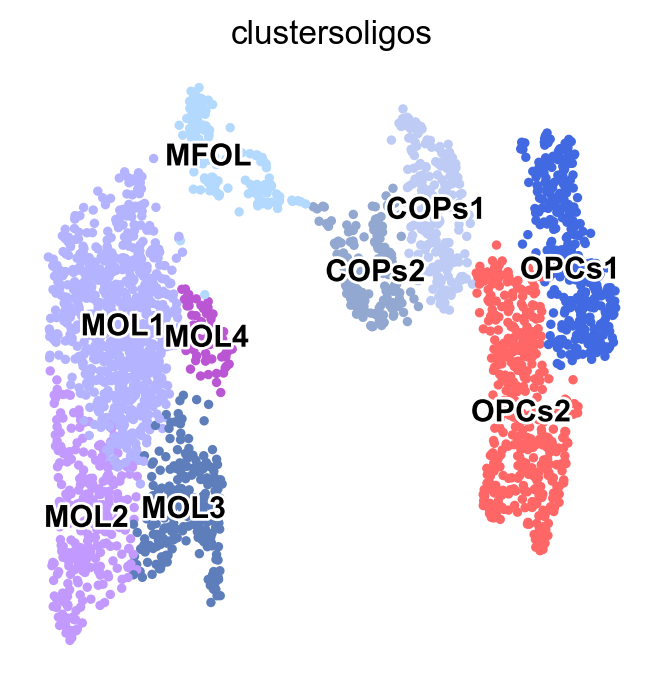

In [138]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_oligos_proc, color=['clustersoligos'],legend_fontoutline=2,legend_loc='on data',legend_fontsize =float(11),
           wspace=0.6, legend_fontweight= 'black', frameon= False,palette=clustersO, save=today+'_1O_clusters.pdf'  )

In [92]:
print(adata_all_oligos_proc.obs['condition'].value_counts())

5dpi_CTRL    1624
INTACT        555
3dpi_CTRL     435
Name: condition, dtype: int64


In [93]:
intact_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='INTACT'],n_obs=435,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='5dpi_CTRL'],n_obs=435,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='3dpi_CTRL'],n_obs=435,copy=True).obs_names
adata_all_oligos_proc_subsam = adata_all_oligos_proc[list(intact_subsam) + list(five_dpi_V_subsam)+list(three_dpi_V_subsam)].copy()

In [94]:
sc.tl.embedding_density(adata_all_oligos_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


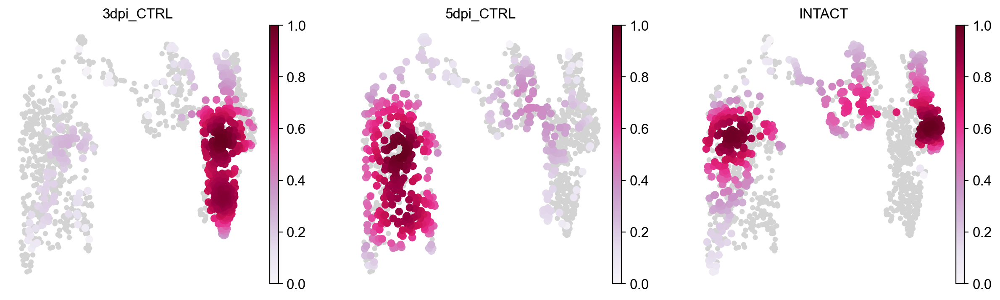

In [95]:
sc.pl.embedding_density(adata_all_oligos_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd',  frameon= False, ncols=5, save=today+'_distribution_downscaling_oligos.png')

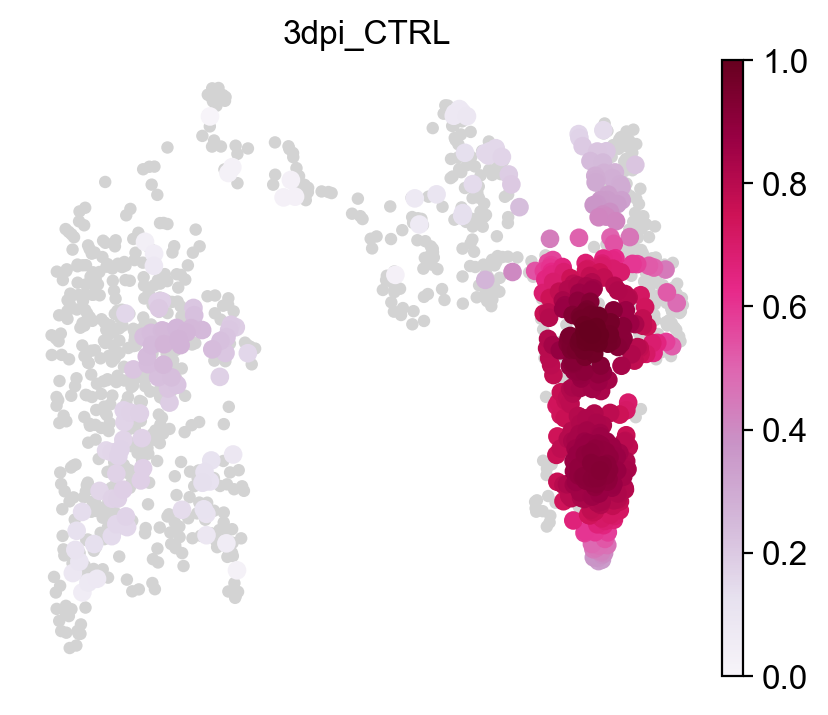

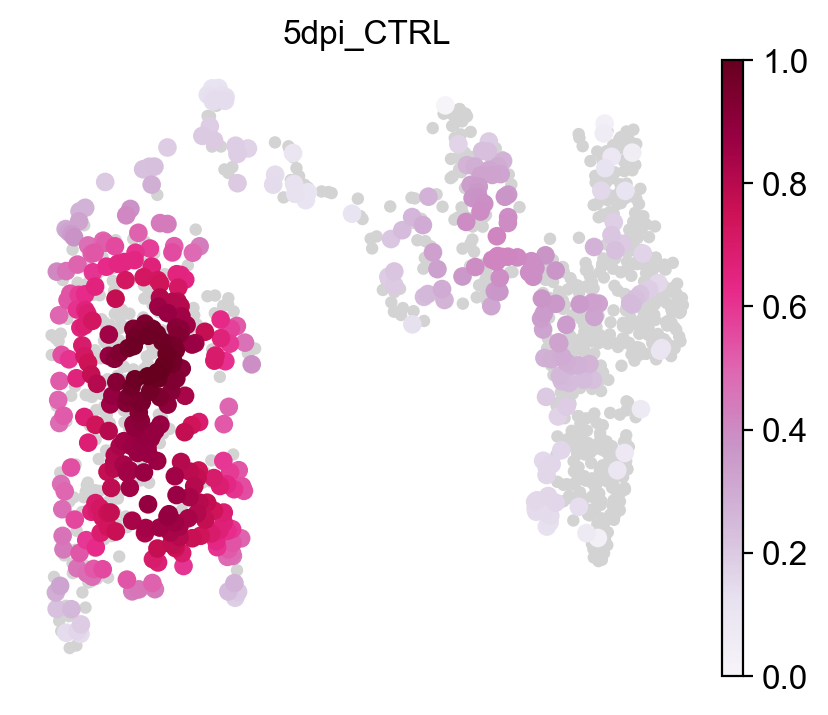

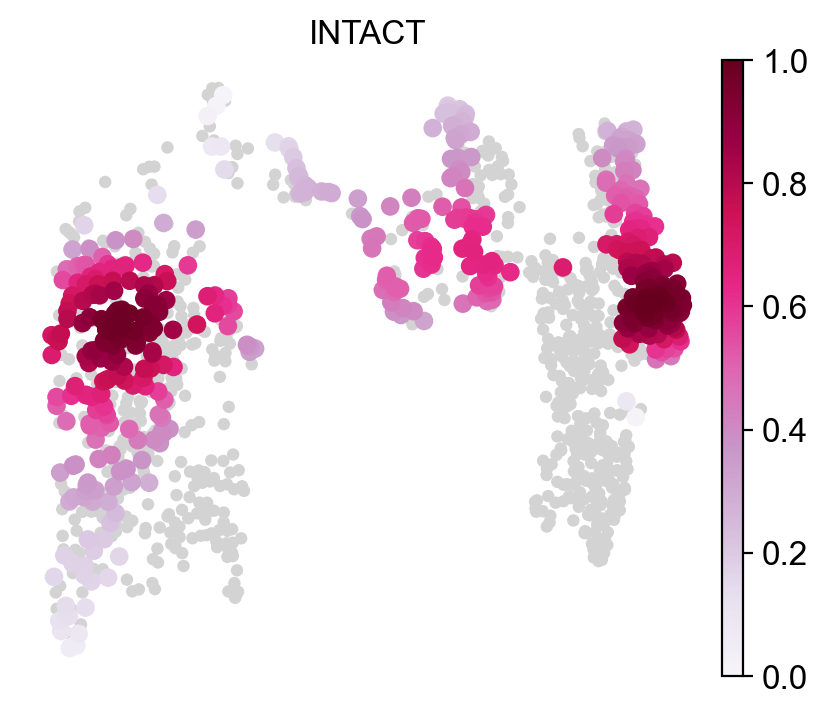

In [137]:
for i in set(adata_all_oligos_proc_subsam.obs['condition']):
    sc.pl.embedding_density(adata_all_oligos_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd', group=i,
                            frameon= False, ncols=5, save=today+i+'_distribution_downscaling_oligos.pdf')

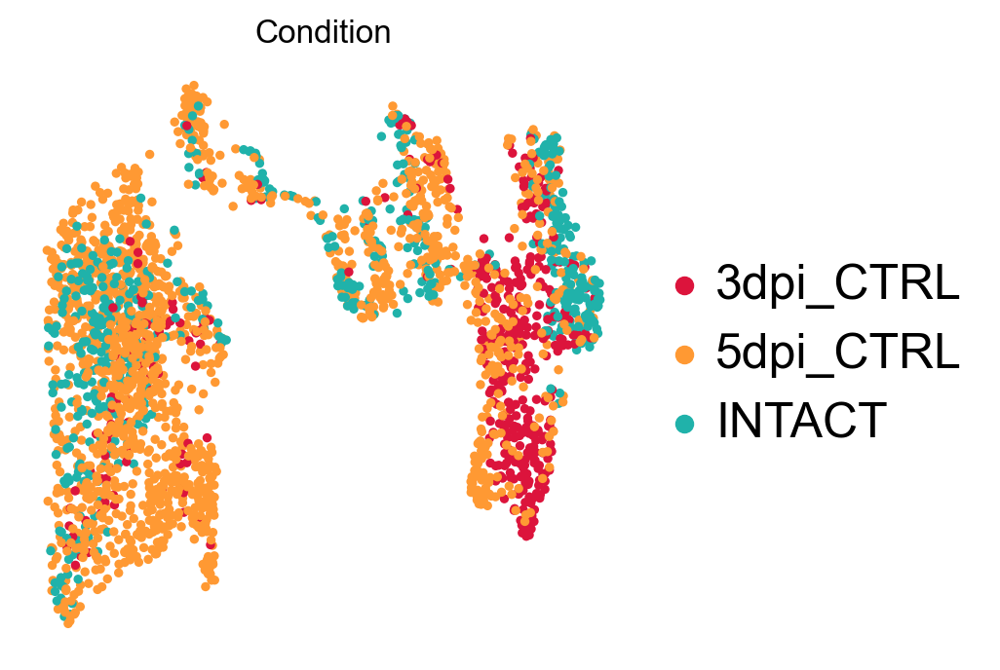

In [98]:
sc.pl.umap(adata_all_oligos_proc, color=['condition'], legend_fontsize =float(18), legend_fontweight= 'normal', title= 'Condition', frameon= False,  save=today+'_3o_condition_all.pdf' )

In [99]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_all_oligos_proc, groupby='clustersoligos', key_added='rank_genes_clustersoligos', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_clustersoligos']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_clustersoligos']`


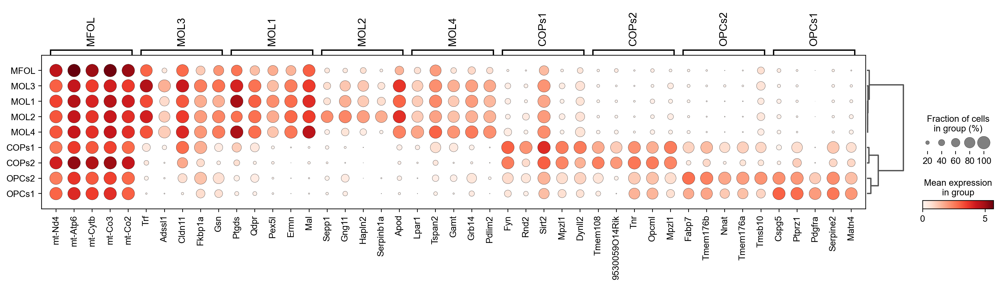

In [100]:
sc.pl.rank_genes_groups_dotplot(adata_all_oligos_proc, n_genes=5, key='rank_genes_clustersoligos', cmap='Reds',
                                save=today+'rank_oligos.pdf')

categories: MOL1, OPCs2, OPCs1, etc.
var_group_labels: OPCs2


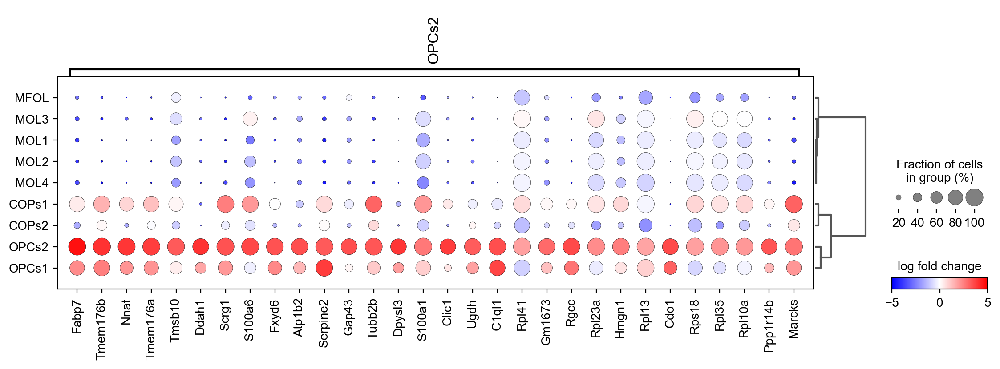

In [156]:
sc.pl.rank_genes_groups_dotplot(adata_all_oligos_proc, n_genes=30, key='rank_genes_clustersoligos',groups=['OPCs2'], cmap='bwr',vmin=-5, vmax=5,
                                 values_to_plot='logfoldchanges',save=today+'rank_oligos_opcs2.pdf')

In [101]:
result = adata_all_oligos_proc.uns['rank_genes_clustersoligos']
groups = result['names'].dtype.names
adata_cloligos_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [102]:
adata_cloligos_genes

,MOL1_n,MOL1_s,MOL1_p,MOL1_l,OPCs2_n,OPCs2_s,OPCs2_p,OPCs2_l,OPCs1_n,OPCs1_s,...,COPs2_p,COPs2_l,MFOL_n,MFOL_s,MFOL_p,MFOL_l,MOL4_n,MOL4_s,MOL4_p,MOL4_l
0,Ptgds,45.374378,5.135124e-251,5.076343,Fabp7,41.414654,6.236684e-203,4.666517,Cspg5,37.683372,...,5.039822e-70,4.746781,mt-Nd4,16.897425,6.623091e-44,2.058121,Lpar1,11.905181,4.523573e-22,2.556442
1,Qdpr,40.002853,1.743790e-208,3.155425,Tmem176b,37.417233,1.846821e-172,3.994764,Ptprz1,36.490841,...,7.247019e-64,4.955304,mt-Atp6,16.857639,4.819531e-44,2.034886,Tspan2,11.710176,1.318260e-19,2.593065
2,Pex5l,39.526512,6.463599e-229,3.140599,Nnat,36.190960,1.138621e-171,3.917610,Pdgfra,34.296062,...,2.608528e-66,3.915318,mt-Cytb,16.580976,5.503950e-43,1.996136,Gamt,11.429545,1.388914e-21,2.636801
3,Ermn,36.540516,6.069202e-182,3.138760,Tmem176a,33.228748,7.048284e-154,3.788794,Serpine2,28.986582,...,3.829180e-62,3.617730,mt-Co3,15.940858,1.051507e-40,2.043020,Grb14,11.338305,1.955591e-19,2.427103
4,Mal,36.184856,2.357578e-176,3.792513,Tmsb10,33.171452,2.425634e-153,3.241580,Matn4,27.704466,...,1.984503e-60,3.645605,mt-Co2,15.529872,4.952908e-39,2.201066,Pdlim2,11.106892,1.728600e-19,2.554156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Scrg1,-25.248970,2.946753e-105,-5.014826,Plp1,-32.477230,1.731781e-139,-5.393317,Mag,-30.637764,...,2.975082e-31,-9.503940,S100a1,-11.423159,4.940630e-24,-3.264838,Bcan,-6.495930,7.731485e-09,-5.051575
19286,Serpine2,-25.587397,5.317470e-108,-4.459103,Sept4,-32.490295,1.084514e-119,-5.877420,Cnp,-30.667311,...,1.439554e-39,-2.996289,Rps5,-11.641354,1.278831e-25,-2.261597,Marcks,-6.559872,6.124353e-09,-4.557922
19287,S100b,-25.620197,1.316271e-113,-3.209522,Aplp1,-33.622166,6.505739e-135,-3.984745,Mbp,-31.934744,...,5.937900e-44,-3.091965,S100a13,-12.058434,2.922050e-26,-3.338248,Rtn1,-6.786386,6.658334e-10,-1.897563
19288,Tmem176b,-26.381889,1.937060e-111,-5.801637,Mag,-38.486183,5.786547e-143,-7.452423,Cldn11,-32.902985,...,2.032081e-52,-4.417865,Ybx1,-12.475687,1.464253e-28,-2.750319,S100a1,-6.883719,4.483669e-10,-2.351641


In [103]:
adata_cloligos_genes.to_csv(table_dir+today+'adata_cloligos_genes.csv')

In [104]:
adata_all_oligos_proc.write(data_dir+today + "adata_all_oligos_proc_cl_scVI.h5ad", compression='gzip')

In [144]:
adata_all_oligos_proc

AnnData object with n_obs × n_vars = 2614 × 13375
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_ctr', 'leiden_ctr07', 'leiden_ctr2', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'S phase', 'Cycling_cells', 'S_phase_cells', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'annotated', 'annotatedgroup', 'common_innate_immunity_signature', 'IRAS1', 'IRAS2',

# save genes for clusters

In [105]:
set(adata_all_oligos_proc.obs['clustersoligos'])

{'COPs1', 'COPs2', 'MFOL', 'MOL1', 'MOL2', 'MOL3', 'MOL4', 'OPCs1', 'OPCs2'}

In [106]:
MOL1 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
MOL2 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
MOL3 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL3', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
MOL4 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL4', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
OPCs1=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='OPCs1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
OPCs2=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='OPCs2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
COPs1=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='COPs1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
COPs2=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='COPs2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
MFOL =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MFOL', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
AG1  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG1', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG2  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG2', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG3  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG3', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG4  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG4', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG5  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG5', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG6  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG6', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG7  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG7', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
MG1  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG1', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG2  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG2', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)  
MG3  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG3', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG4  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG4', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG5  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG5', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG6  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG6', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG7  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG7', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG8  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG8', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)


In [107]:
d_MOL1 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_MOL2 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_MOL3 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL3', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_MOL4 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL4', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_OPCs1=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='OPCs1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_OPCs2=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='OPCs2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_COPs1=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='COPs1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_COPs2=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='COPs2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_MFOL =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MFOL', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG1  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG1', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG2  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG2', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG3  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG3', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG4  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG4', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG5  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG5', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG6  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG6', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG7  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG7', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG1  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG1', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG2  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG2', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)  
d_MG3  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG3', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG4  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG4', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG5  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG5', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG6  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG6', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG7  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG7', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG8  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG8', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)


In [108]:
clusters_enriched_genes = {
'MOL1': pd.Series(MOL1['names']),
'MOL2': pd.Series(MOL2['names']),
'MOL3': pd.Series(MOL3['names']),
'MOL4': pd.Series(MOL4['names']),
'OPCs1': pd.Series(OPCs1['names']),
'OPCs2': pd.Series(OPCs2['names']),
'COPs1': pd.Series(COPs1['names']),
'COPs2': pd.Series(COPs2['names']),
'MFOL':  pd.Series(MFOL['names']),
'AG1':   pd.Series(AG1['names']),
'AG2':   pd.Series(AG2['names']),   
'AG3':   pd.Series(AG3['names']),  
'AG4':   pd.Series(AG4['names']),  
'AG5':   pd.Series(AG5['names']), 
'AG6':   pd.Series(AG6['names']),  
'AG7':   pd.Series(AG7['names']),  
'MG1':   pd.Series(MG1['names']),  
'MG2':   pd.Series(MG2['names']),
'MG3':   pd.Series(MG3['names']),
'MG4':   pd.Series(MG4['names']),
'MG5':   pd.Series(MG5['names']),
'MG6':   pd.Series(MG6['names']),
'MG7':   pd.Series(MG7['names']),
'MG8':   pd.Series(MG8['names'])}

In [109]:
clusters_down_genes = {
'MOL1': pd.Series(d_MOL1['names']),
'MOL2': pd.Series(d_MOL2['names']),
'MOL3': pd.Series(d_MOL3['names']),
'MOL4': pd.Series(d_MOL4['names']),
'OPCs1': pd.Series(d_OPCs1['names']),
'OPCs2': pd.Series(d_OPCs2['names']),
'COPs1': pd.Series(d_COPs1['names']),
'COPs2': pd.Series(d_COPs2['names']),
'MFOL':  pd.Series(d_MFOL['names']),
'AG1':   pd.Series(d_AG1['names']),
'AG2':   pd.Series(d_AG2['names']),   
'AG3':   pd.Series(d_AG3['names']),  
'AG4':   pd.Series(d_AG4['names']),  
'AG5':   pd.Series(d_AG5['names']), 
'AG6':   pd.Series(d_AG6['names']),  
'AG7':   pd.Series(d_AG7['names']),  
'MG1':   pd.Series(d_MG1['names']),  
'MG2':   pd.Series(d_MG2['names']),
'MG3':   pd.Series(d_MG3['names']),
'MG4':   pd.Series(d_MG4['names']),
'MG5':   pd.Series(d_MG5['names']),
'MG6':   pd.Series(d_MG6['names']),
'MG7':   pd.Series(d_MG7['names']),
'MG8':   pd.Series(d_MG8['names']),
}

In [110]:
clusters_enriched_genesdf=pd.DataFrame(clusters_enriched_genes)

In [111]:
clusters_enriched_genesdf=clusters_enriched_genesdf.replace(np.nan, '', regex=True)

In [112]:
clusters_enriched_genesdf

,MOL1,MOL2,MOL3,MOL4,OPCs1,OPCs2,COPs1,COPs2,MFOL,AG1,...,AG6,AG7,MG1,MG2,MG3,MG4,MG5,MG6,MG7,MG8
0,Ptgds,Sepp1,Trf,Lpar1,Cspg5,Fabp7,Fyn,Tmem108,mt-Nd4,Sfrp5,...,Gfap,Ftl1,Jun,Nfkbia,AY036118,Cd52,C3ar1,Atp1a2,Rpl41,mt-Co3
1,Qdpr,Gng11,Adssl1,Tspan2,Ptprz1,Tmem176b,Rnd2,9530059O14Rik,mt-Atp6,Ackr3,...,Fabp3,Tnfrsf12a,Klf2,Ccrl2,Gm42418,Ctsb,Marcksl1,Slc1a2,Tmsb4x,mt-Co2
2,Pex5l,Hapln2,Cldn11,Gamt,Pdgfra,Nnat,Sirt2,Tnr,mt-Cytb,Cyp27a1,...,Irf7,Hmox1,Fos,Cd83,Nrgn,Lgals3bp,Cd83,mt-Cytb,Rps2,mt-Atp6
3,Ermn,Serpinb1a,Fkbp1a,Grb14,Serpine2,Tmem176a,Mpzl1,Opcml,mt-Co3,Gm17705,...,Calb1,Cdkn1a,Fosb,Atf3,Syt1,Apoe,Plek,mt-Co3,Rps26,mt-Co1
4,Mal,Apod,Gsn,Pdlim2,Matn4,Tmsb10,Dynll2,Mpzl1,mt-Co2,Slco4a1,...,Oas1a,Esd,Btg2,Junb,Atp1b1,Tspo,Plekho2,mt-Nd4,Rpl32,mt-Nd2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1677,,,,,,Rai2,,,,,...,,,,,,,,,,
1678,,,,,,Lingo4,,,,,...,,,,,,,,,,
1679,,,,,,Mid2,,,,,...,,,,,,,,,,
1680,,,,,,Mr1,,,,,...,,,,,,,,,,


In [113]:
clusters_enriched_genesdf.to_csv(table_dir+ today + 'glialclusters_enriched_genes.csv')

In [114]:
clusters_down_genesdf=pd.DataFrame(clusters_down_genes)

In [115]:
clusters_down_genesdf=clusters_down_genesdf.replace(np.nan, '', regex=True)

In [116]:
clusters_down_genesdf

,MOL1,MOL2,MOL3,MOL4,OPCs1,OPCs2,COPs1,COPs2,MFOL,AG1,...,AG6,AG7,MG1,MG2,MG3,MG4,MG5,MG6,MG7,MG8
0,Ank1,Lrrc16a,Zfp383,Rnd2,Moxd1,Gltscr1,Nbl1,Fam229b,Nap1l3,Sun3,...,Abcc1,Bckdhb,Tgfbr3,4930556M19Rik-1,Prr11,Gm3264,Anxa2,Lilrb4a,Zcchc8,Lsm5
1,Zfp54,Npl,Trim62,Sox11,Gm10263,9330111N05Rik,Cdc20,Fam151b,Efemp2,Myof,...,Mfsd9,Nek1,Gm43087,Fignl1,Mmrn2,Gm26981,Sh2d3c,Lgals3,Phc2,Cir1
2,Fam196a,Stambpl1,Azin2,Tmem121,8030462N17Rik,Vamp1,Gfra2,Diaph1,Hyal2,Cd200r1,...,Pcdhb17,Hip1r,Cep126,Sema4f,Chaf1a,Nwd1,Rnf26,Spp1,Fam208b,Upk1b
3,A330041J22Rik,H2-Q4,Shisa7,Mro,Kitl,Sftpc,Smpd3,Slc25a45,Tspan12,Acaa1b,...,Zfp784,Gpr155,March11,Cped1,Cspg4,Txnrd3,Cbx8,Lpl,Nup214,Serpinf1
4,Kctd8,Zfp503,Unc13c,Nlgn2,Rab37,Gm38335,Zbtb16,Gpalpp1,Cdpf1,Scube3,...,Gp1bb,Zfp280c,Amigo2,Rhov,Stra6l,Entpd2,Shank1,Ifitm3,Sos2,Pin1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1756,Scrg1,,,,,,,,,,...,,,,,,,,,,
1757,Serpine2,,,,,,,,,,...,,,,,,,,,,
1758,S100b,,,,,,,,,,...,,,,,,,,,,
1759,Tmem176b,,,,,,,,,,...,,,,,,,,,,


In [117]:
clusters_down_genesdf.to_csv(table_dir+ today + 'glialclusters_down_genes.csv')

In [118]:
table_dir + 'glialclusters_enriched_genes.csv'

'/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Revision/tables/glialclusters_enriched_genes.csv'

In [119]:
today

'230830'

# Find injury clusters

In [120]:
adata_ctr_proce3dpi= sc.read('/Volumes/Seagate_Exp/Paper_sc_analysis/data_earlytp/220701adata_ctr_proce3dpiIntact2.h5ad')

In [121]:
adata_ctr_proce3dpi.obs_keys

<bound method AnnData.obs_keys of AnnData object with n_obs × n_vars = 6322 × 19290
    obs: 'sample_id', 'sample_id_str', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'sample', 'experiment', 'size_factors', 'leiden13', 'leiden2', 'Microglia', 'Disease_associated_microglia', 'Macrophages', 'annotated13', 'annotated2', 'Disease associated microglia', 'Monocytes', 'Granulocytes/ dendritic cells', 'NK cells', 'T cells', 'B-cells', 'Neutrophils', 'Neurons', 'Oligodendrocytes', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'BAM', 'OPCs', 'COPs', 'MOL', 'DAM', 'DC', 'B cells', 'gd T cells', 'Innate lymphoid cells (ILC) 2', 'NKT cells'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_

In [122]:
adata_all_oligos_proc.obs['annotated2_3dpi'] = adata_ctr_proce3dpi.obs['annotated2'].astype('category')

In [123]:
adata_all_oligos_proc.uns['annotated2_3dpi_colors']=adata_ctr_proce3dpi.uns['annotated2_colors']

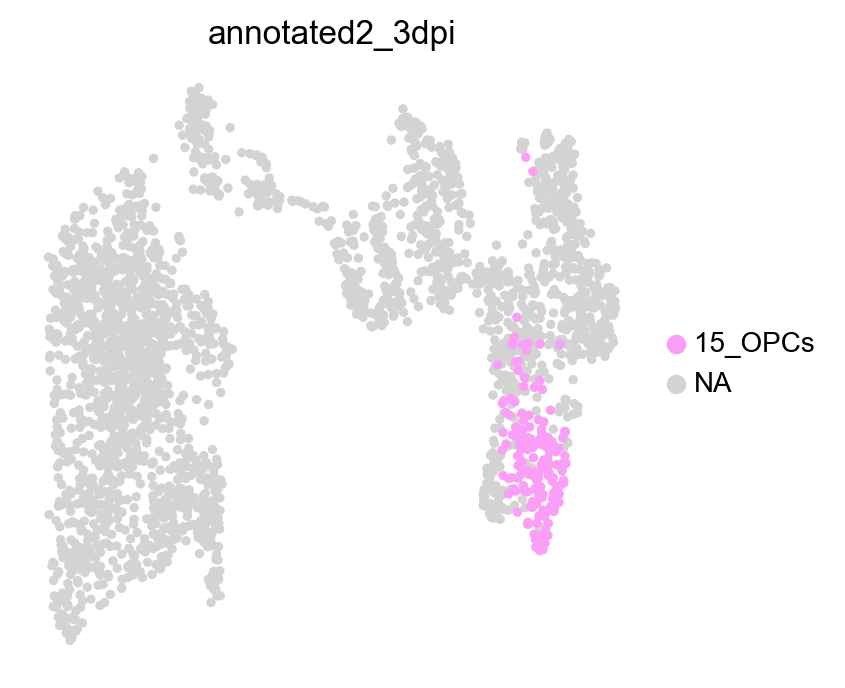

In [124]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_oligos_proc, color=['annotated2_3dpi'], legend_fontsize =float(10), groups=['15_OPCs'],
           wspace=0.6, legend_fontweight= 'black', frameon= False, save=today+'_oligos_15_OPCs.pdf'  )

In [125]:
adata_all_astros_proc.obs['annotated2_3dpi'] = adata_ctr_proce3dpi.obs['annotated2'].astype('category')

In [126]:
adata_all_astros_proc.uns['annotated2_3dpi_colors']=adata_ctr_proce3dpi.uns['annotated2_colors']

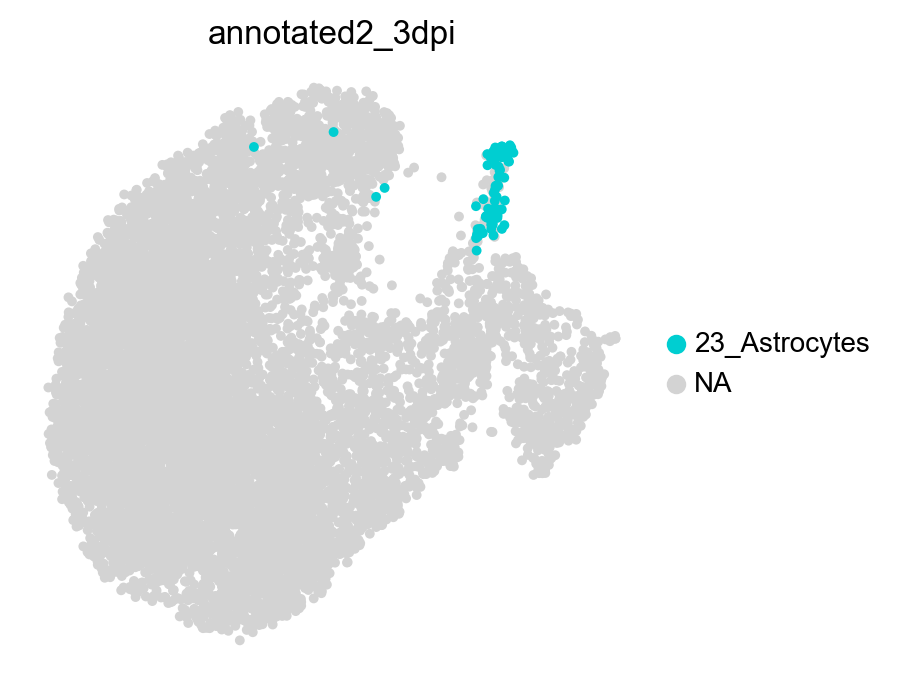

In [131]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_astros_proc, color=['annotated2_3dpi'], legend_fontsize =float(10), groups=['23_Astrocytes'],size=50,palette=['#00CED1'],
           wspace=0.6, legend_fontweight= 'black', frameon= False, save=today+'_astros_23_Astrocytes.pdf'  )

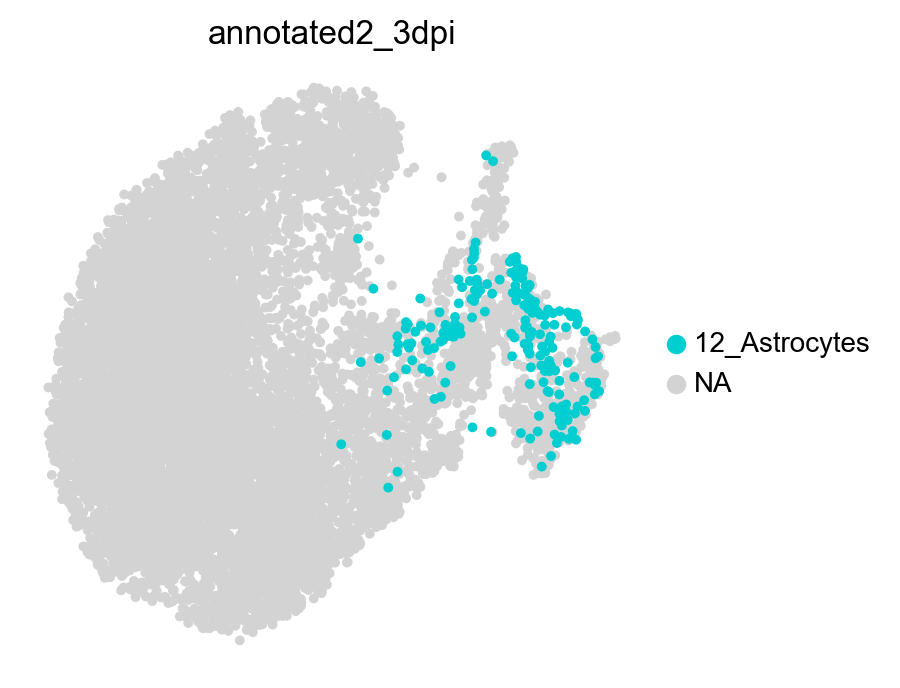

In [132]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_astros_proc, color=['annotated2_3dpi'], legend_fontsize =float(10), groups=['12_Astrocytes'],size=50,palette=['#00CED1'],
           wspace=0.6, legend_fontweight= 'black', frameon= False, save=today+'_astros_12_Astrocytes.pdf'  )

In [133]:
adata_all_micro_proc.obs['annotated2_3dpi'] = adata_ctr_proce3dpi.obs['annotated2'].astype('category')

In [134]:
adata_all_micro_proc.uns['annotated2_3dpi_colors']=adata_ctr_proce3dpi.uns['annotated2_colors']

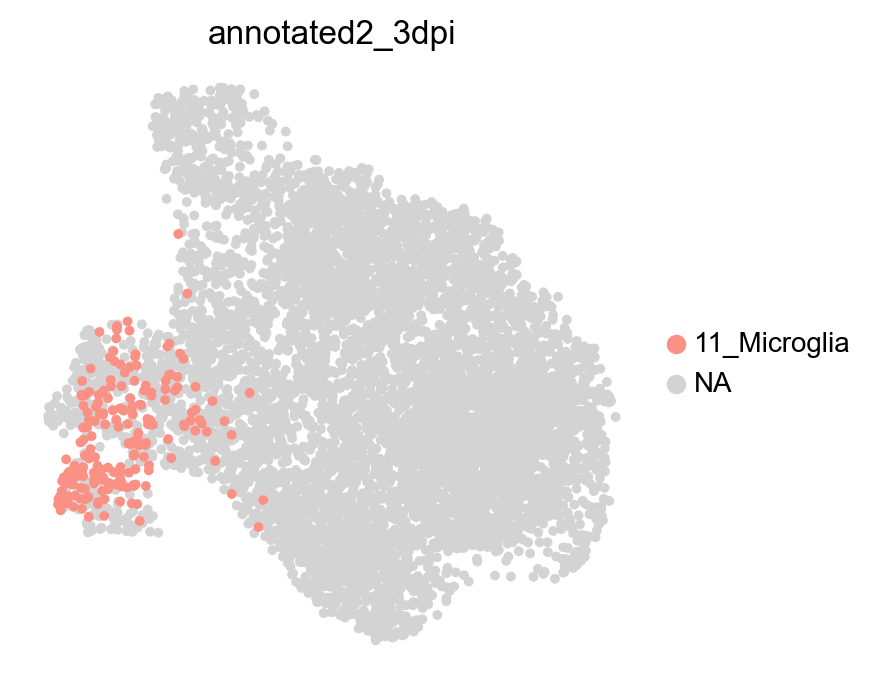

In [136]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_micro_proc, color=['annotated2_3dpi'], legend_fontsize =float(10), groups=['11_Microglia'],size=50,
           wspace=0.6, legend_fontweight= 'black', frameon= False,save=today+'_micro_11_Microglia.pdf'  )